# Chapter 1: Basic Image and Video Processing 

## Problems 

## 1. Display RGB image color channels in 3D

In [6]:
from IPython.core.display import display,HTML
display(HTML('<style>.prompt{width: 0px; min-width: 0px; visibility: collapse}</style>'))

In [3]:
# comment the next line only if you are not running this code from jupyter notebook
%matplotlib inline
from skimage.io import imread
import numpy as np
import matplotlib.pylab as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib import cm
from matplotlib.ticker import LinearLocator, FormatStrFormatter

In [20]:
def plot_3d(X, Y, Z, cmap='Reds', title=''):
    """
    This function plots 3D visualization of a channel
    It displays (x, y, f(x,y)) for all x,y values
    """ 

    fig = plt.figure(figsize=(15,15))
    ax = fig.gca(projection='3d')
    # Plot the surface.
    surf = ax.plot_surface(X, Y, Z, cmap=cmap, linewidth=0, antialiased=False, rstride=2, cstride=2, alpha=0.5)
    ax.xaxis.set_major_locator(LinearLocator(10))
    ax.xaxis.set_major_formatter(FormatStrFormatter('%.02f'))
    ax.view_init(elev=10., azim=5)
    ax.set_title(title, size=20)
    plt.show()

In [ ]:
im = imread('images/Img_01_01.jpg')

In [ ]:
Y = np.arange(im.shape[0])
X = np.arange(im.shape[1])
X, Y = np.meshgrid(X, Y)

In [21]:
Z1 = im[...,0]
Z2 = im[...,1]
Z3 = im[...,2]

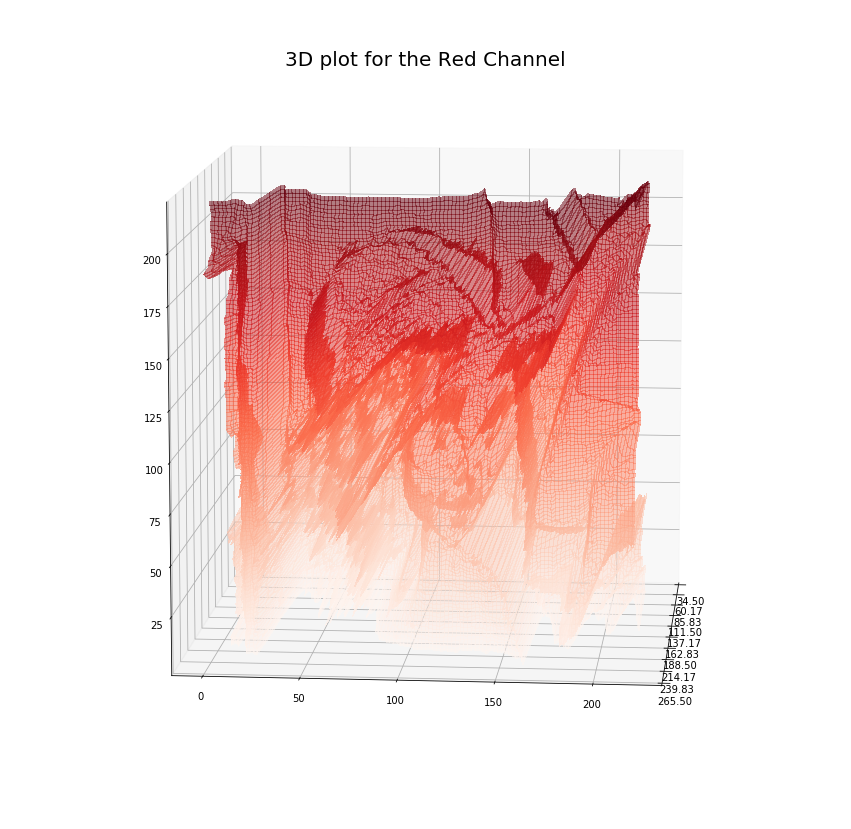

In [22]:
# plot 3D visualizations of the R, G, B channels of the image respectively
plot_3d(Z1, X, im.shape[1]-Y, cmap='Reds', title='3D plot for the Red Channel')

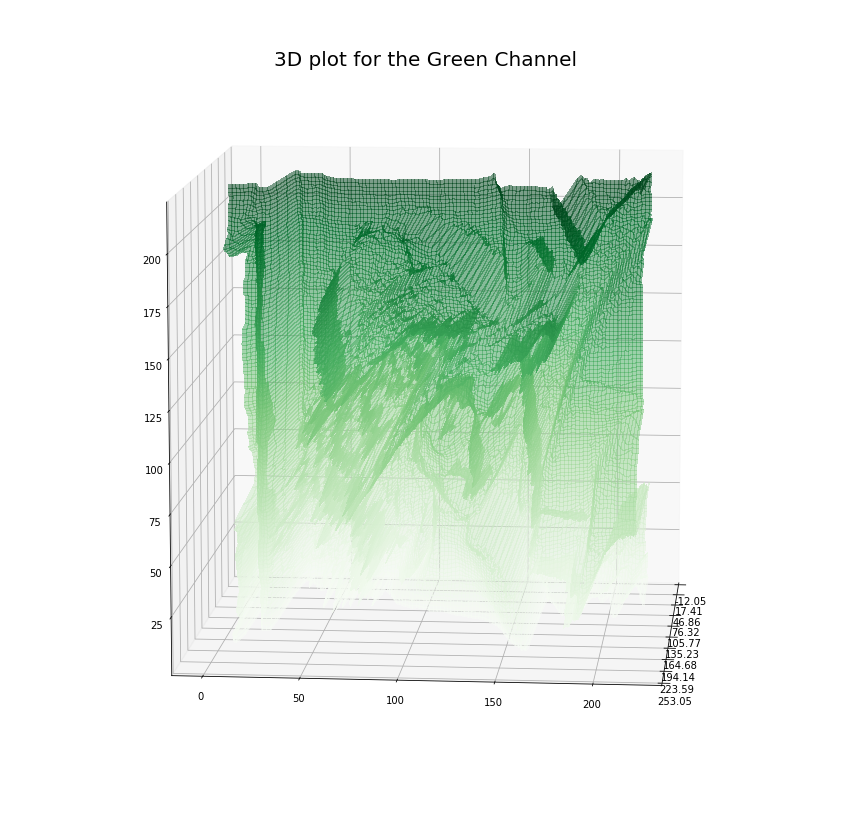

In [23]:
plot_3d(Z2, X, im.shape[1]-Y, cmap='Greens', title='3D plot for the Green Channel')

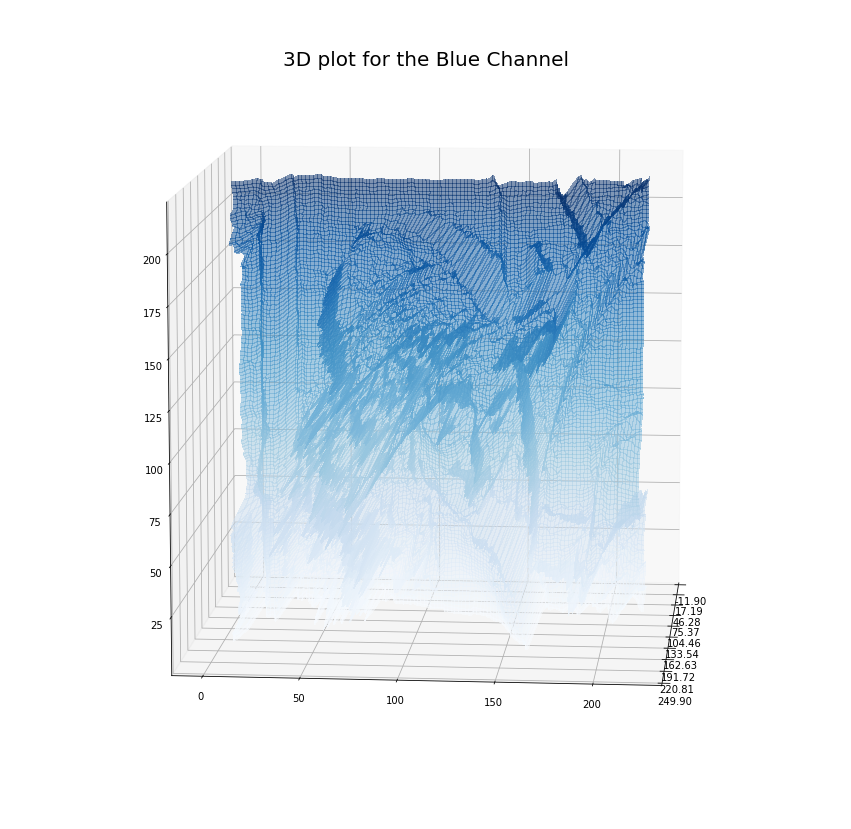

In [24]:
plot_3d(Z3, X, im.shape[1]-Y, cmap='Blues', title='3D plot for the Blue Channel')

## 2.  Video I/O

### 2.1 Read/Write Video Files with scikit-video

In [25]:
import skvideo.io
import numpy as np
import matplotlib.pylab as plt

In [34]:
# set keys and values for parameters in ffmpeg
inputparameters = {}
outputparameters = {}
reader = skvideo.io.FFmpegReader('images/Vid_01_01.mp4',
                inputdict=inputparameters,
                outputdict=outputparameters)

In [35]:
## Read video file
num_frames, height, width, num_channels = reader.getShape()
print(num_frames, height, width, num_channels)
# 600 916 1920 3

600 916 1920 3


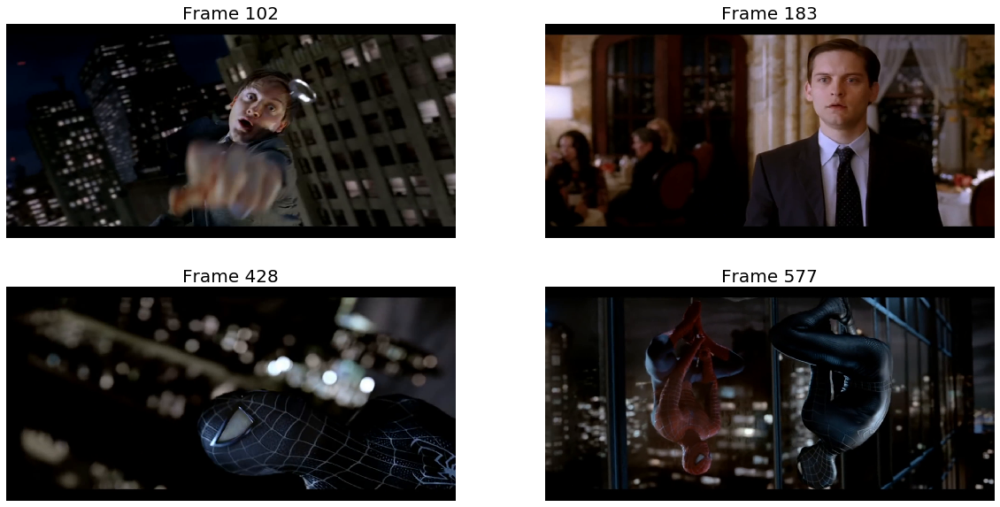

In [36]:
plt.figure(figsize=(20,10))
# iterate through the frames and display a few frames
frame_list = np.random.choice(num_frames, 4)
i, j = 0, 1
for frame in reader.nextFrame():
    if i in frame_list:
        plt.subplot(2,2,j)
        plt.imshow(frame)
        plt.title("Frame {}".format(i), size=20)
        plt.axis('off')
        j += 1
    i += 1
plt.show()

In [ ]:
from skimage.color import rgb2gray
from skimage.filters import threshold_otsu

writer = skvideo.io.FFmpegWriter("images/spiderman_binary.mp4", outputdict={})    
for frame in skvideo.io.vreader("images/Vid_01_01.mp4"):
    frame = rgb2gray(frame)
    thresh = threshold_otsu(frame)
    binary = np.zeros((frame.shape[0], frame.shape[1], 3), dtype=np.uint8)
    binary[...,0] = binary[...,1] = binary[...,2] = 255*(frame > thresh).astype(np.uint8)
    writer.writeFrame(binary)
writer.close()

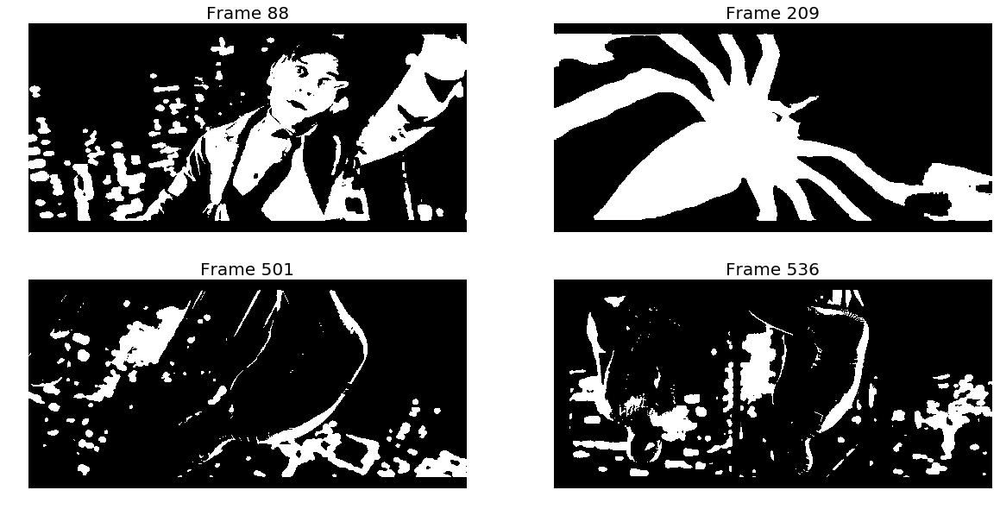

In [19]:
plt.figure(figsize=(20,10))
# iterate through the frames and display a few frames
reader = skvideo.io.FFmpegReader("images/spiderman_binary.mp4")
num_frames, height, width, num_channels = reader.getShape()
frame_list = np.random.choice(num_frames, 4)
i, j = 0, 1
for frame in reader.nextFrame():
    if i in frame_list:
        plt.subplot(2,2,j)
        plt.imshow(frame)
        plt.title("Frame {}".format(i), size=20)
        plt.axis('off')
        j += 1
    i += 1
plt.show()

### 2.2 Capture Video from camera, extract frames with opencv-python

In [ ]:
# comment the next line only if you are not running this code from jupyter notebook
# %matplotlib notebook

import cv2
import matplotlib.pyplot as plt

In [ ]:
vc = cv2.VideoCapture(0)
plt.ion()
if vc.isOpened(): # try to get the first frame
    is_capturing, frame = vc.read()    
    webcam_preview = plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))    
else:
    is_capturing = False

In [ ]:
# capture 10 frames
frame_index = 1
while is_capturing:
    
    if frame_index > 10: break
        
    is_capturing, frame = vc.read()
    image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)    # makes the blues image look real colored
    webcam_preview.set_data(image)
    plt.title('Frame {0:d} '.format(frame_index))
    plt.draw()
    frame_index += 1

    try:    # Avoids a NotImplementedError caused by `plt.pause`
        plt.pause(2)
    except Exception:
        pass
    
vc.release()

## 3.  Implement Instagram-like Gotham Filter

![](images/Img_01_03.jpg)

In [10]:
from PIL import Image
import numpy as np
import matplotlib.pylab as plt

im = Image.open('images/Img_01_03.jpg') # assumed pixel values in [0,255]
print(np.max(im))
# 255

255


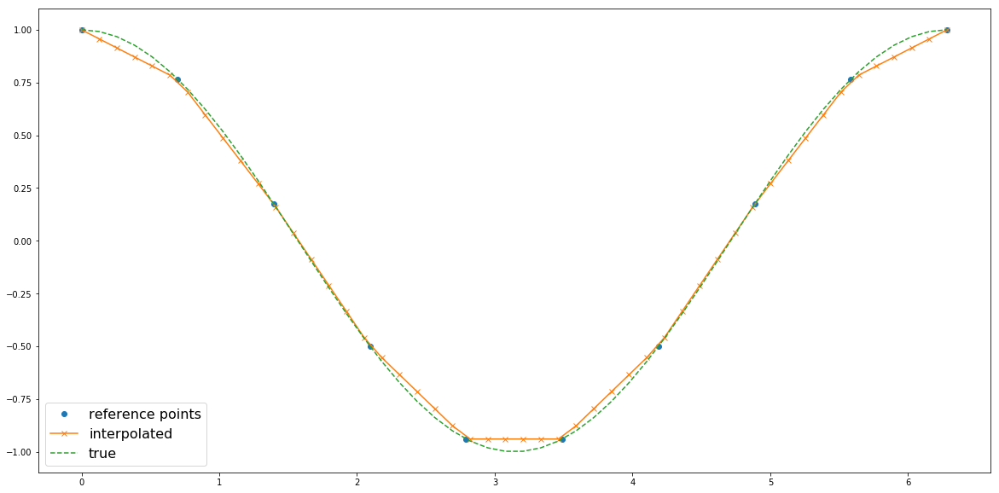

In [5]:
# reference points
x_p = np.linspace(0, 2*np.pi, 10) # generate sequence of 10 points (numbers) evenly spaced in the interval [0, 2π] 
# true values at reference points
y_p = np.cos(x_p)
# test points
x = np.linspace(0, 2*np.pi, 50) # generate sequence of 50 test points (numbers) evenly spaced in the interval [0, 2π]
# true values at all points
y = np.cos(x)
# interpolated values at all test points
y_interp = np.interp(x, x_p, y_p)
# now plot
plt.figure(figsize=(20,10)) 
plt.plot(x_p, y_p, 'o', label='reference points')
plt.plot(x, y_interp, '-x', label='interpolated')
plt.plot(x, y, '--', label='true')
plt.legend(prop={'size': 16})
plt.show()

In [ ]:
r, g, b = im.split() # split the channels into red, green and blue
r_old = np.linspace(0,255,11)   # reference points
r_new = [0., 12.75, 25.5, 51., 76.5, 127.5, 178.5, 204., 229.5, 242.25, 255.] # new values at reference points

# strech the red channel histogram with interpolation and obtain new red channel values for each pixel                       
r1 = Image.fromarray((np.reshape(np.interp(np.array(r).ravel(), r_old, r_new),
                                 (im.height, im.width))).astype(np.uint8), mode='L')

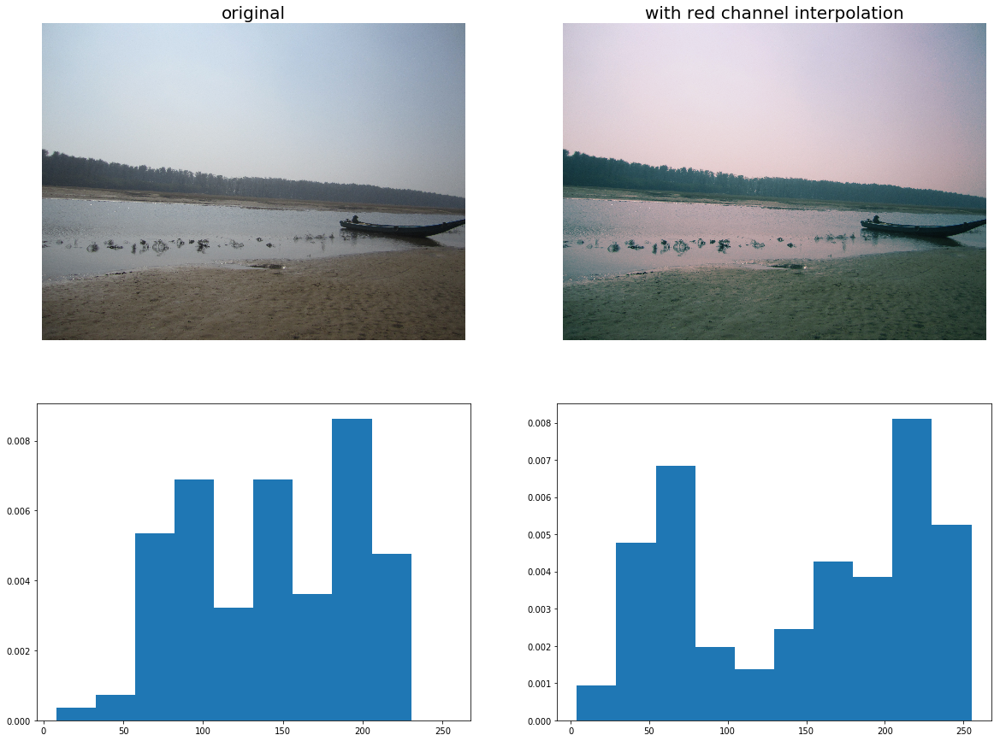

In [12]:
# plot with 2x2 subplots
plt.figure(figsize=(20,15))
plt.subplot(221)
plt.imshow(im)
plt.title('original', size=20)
plt.axis('off')
plt.subplot(222)
im1 = Image.merge('RGB', (r1, g, b))
plt.imshow(im1)
plt.axis('off')
plt.title('with red channel interpolation', size=20)
plt.subplot(223)
plt.hist(np.array(r).ravel(), normed=True)
plt.subplot(224)
plt.hist(np.array(r1).ravel(), normed=True)
plt.show()

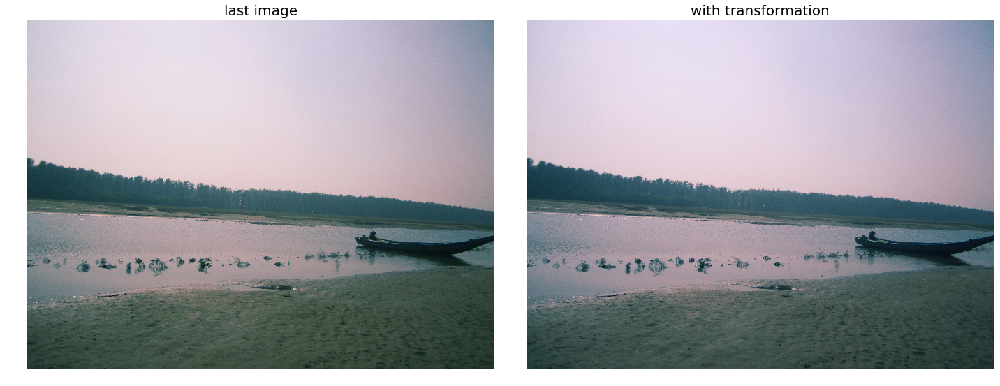

In [5]:
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im1)
plt.title('last image', size=20)
plt.axis('off')
b1 = Image.fromarray(np.clip(np.array(b) + 7.65, 0, 255).astype(np.uint8))
im1 = Image.merge('RGB', (r1, g, b1))
plt.subplot(122)
plt.imshow(im1)
plt.axis('off')
plt.title('with transformation', size=20)
plt.tight_layout()
plt.show()

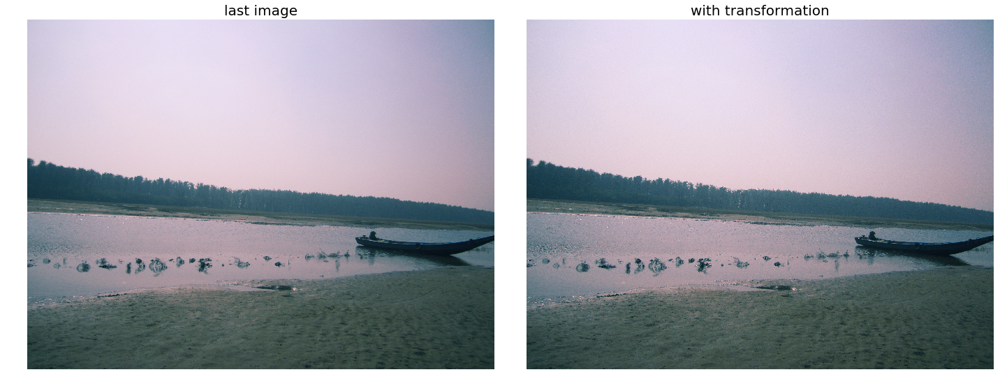

In [6]:
from PIL.ImageEnhance import Sharpness

plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im1)
plt.title('last image', size=20)
plt.axis('off')
im2 = Sharpness(im1).enhance(3.0)
plt.subplot(122)
plt.imshow(im2)
plt.axis('off')
plt.title('with transformation', size=20)
plt.tight_layout()
plt.show()

In [ ]:
blue_old = np.linspace(0,255,17) # pixel values at reference points
blue_new = [0., 11.985, 30.09, 64.005, 81.09, 99.96, 107.1, 111.945, 121.125, 143.055, 147.9, 159.885, 171.105, 
               186.915, 215.985, 235.875, 255.] # new pixel values at the reference points
# now perform a blue channel interpolation
b2 = Image.fromarray((np.reshape(np.interp(np.array(b1).ravel(), blue_old, blue_new), 
                                 (im.height, im.width))).astype(np.uint8), mode='L')

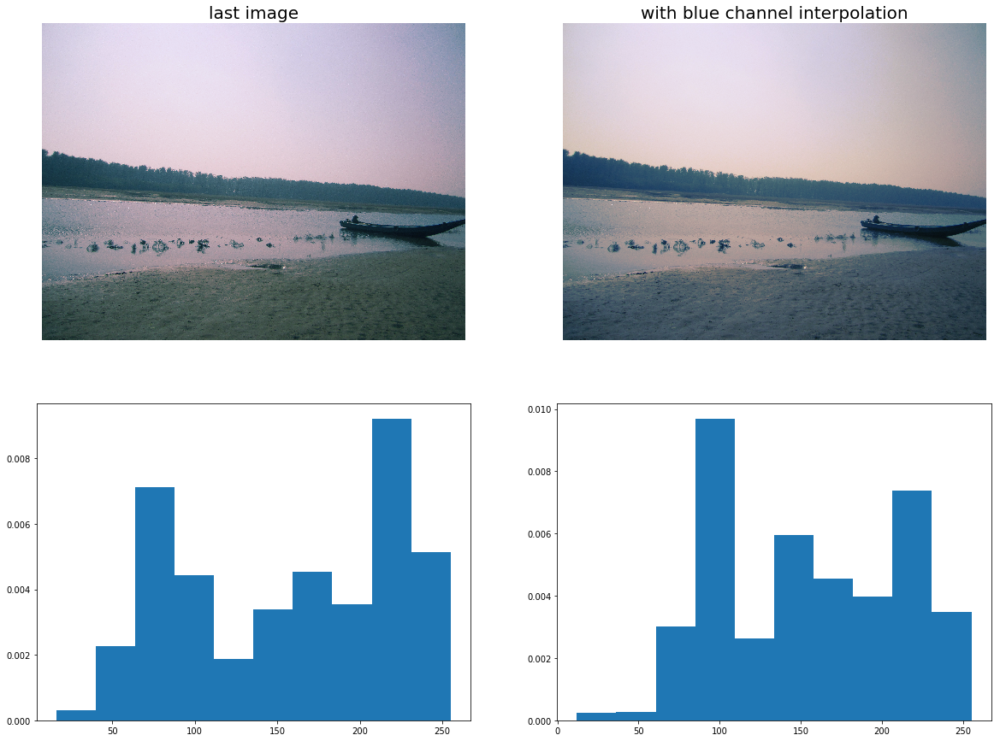

In [7]:
plt.figure(figsize=(20,15))
plt.subplot(221)
plt.imshow(im2)
plt.title('last image', size=20)
plt.axis('off')
plt.subplot(222)
im3 = Image.merge('RGB', (r1, g, b2))
plt.imshow(im3)
plt.axis('off')
plt.title('with blue channel interpolation', size=20)
plt.subplot(223)
plt.hist(np.array(b1).ravel(), normed=True)
plt.subplot(224)
plt.hist(np.array(b2).ravel(), normed=True)
plt.show()

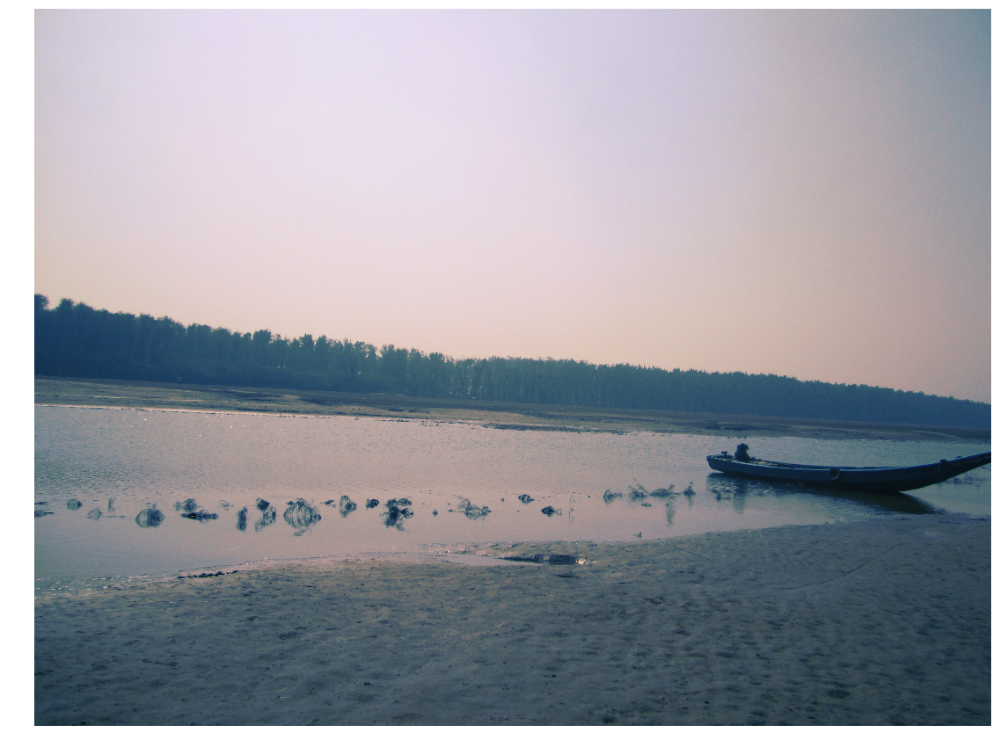

In [8]:
plt.figure(figsize=(20,15))
plt.imshow(im3)
plt.axis('off')
plt.show()

## 4.  Explore image manipulations with different python libraries

### 4.1 Plot image montage with scikit-image

In [ ]:
from skimage.io import imread
from skimage.util import random_noise, montage
import matplotlib.pylab as plt
import numpy as np
im = imread("images/Img_01_04.jpg")

In [ ]:
sigmas = np.linspace(0, 1, 9) # create 9 standard deviation values in the increasing order starting from 0 to 1
noisy_images = np.zeros((9, im.shape[0], im.shape[1], im.shape[2]))
for i in range(len(sigmas)): 
    noisy_images[i,:,:,:] = random_noise(im, var=sigmas[i]**2) # add Gaussian random noise to image with different sigma values

In [ ]:
noisy_images_montage = montage(noisy_images, rescale_intensity=True, multichannel=True) # create montage

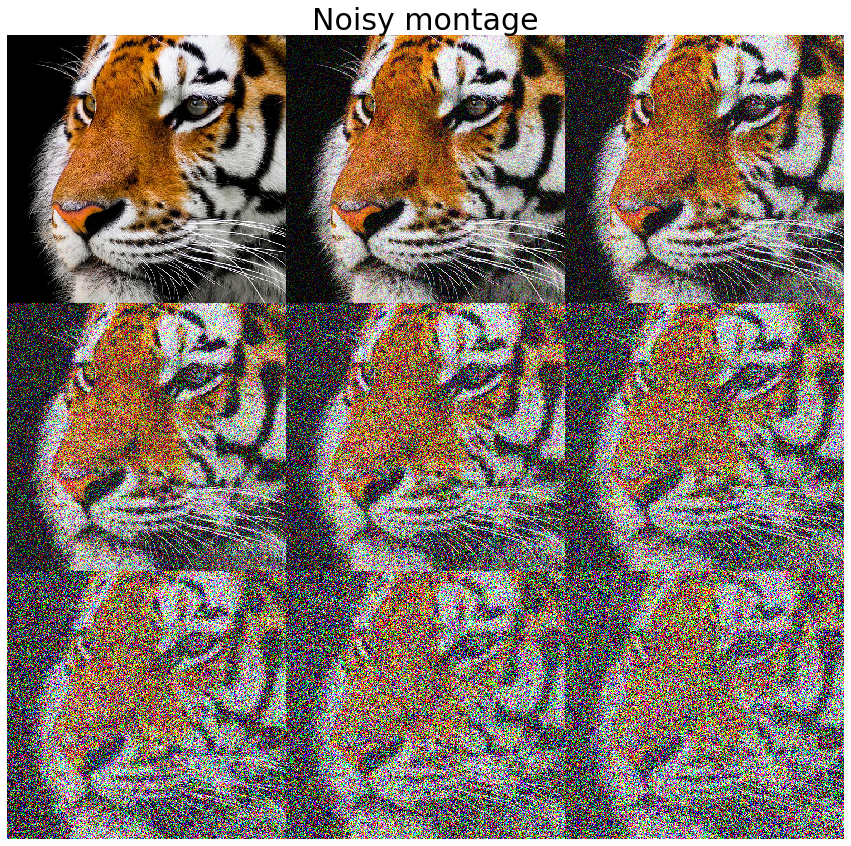

In [1]:
plt.figure(figsize=(15,15))
plt.imshow(noisy_images_montage)
plt.title('Noisy montage', size=30)
plt.axis('off')
plt.show()

### 4.2 Crop / Resize images with scipy ndimage module

In [6]:
from scipy import ndimage
import matplotlib.pyplot as plt
from skimage.io import imread

In [7]:
im = imread('images/Img_01_05.jpg') / 255
zoomed_im = ndimage.zoom(im, (2,2,1), mode='nearest', order=1) # no zoom on color channel, order of the spline interpolation = 1
print(im.shape, zoomed_im.shape)
# (320, 475, 3) (640, 950, 3)

(320, 475, 3) (640, 950, 3)


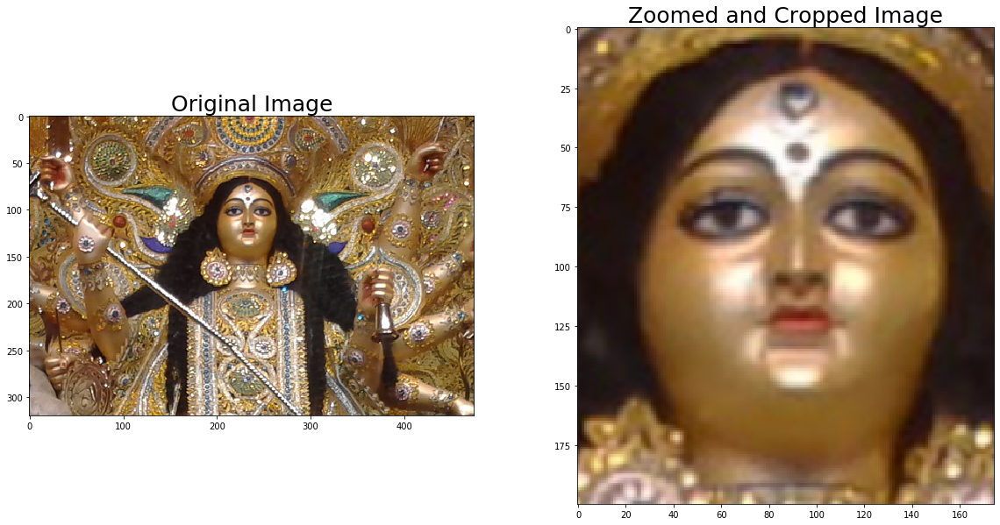

In [8]:
plt.figure(figsize=(20,10))
plt.subplot(121)
plt.imshow(im)
plt.title('Original Image', size=25)
plt.subplot(122)
plt.imshow(zoomed_im[125:325,375:550,:]) # crop the enlarged face
plt.title('Zoomed and Cropped Image', size=25)
plt.show()

### 4.3  Draw contours with opencv-python

In [2]:
import cv2
import numpy as np
import matplotlib.pylab as plt

image = cv2.imread("images/Img_01_06.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB) # convert from cv2 BGR to matplotlib RGB

In [3]:
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edged = cv2.Canny(gray, 125, 250)
contours_edged, _ = cv2.findContours(edged, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
print("Number of Contours found with Canny edges = " + str(len(contours_edged)))
# 967

Number of Contours found with Canny edges = 967


In [4]:
ret, thresh = cv2.threshold(gray, 127, 255, 0)
contours_thresh, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
print("Number of Contours found with threshold = " + str(len(contours_thresh)))
# 640

Number of Contours found with threshold = 640


(Text(0.5, 1.0, 'Contour Lines with Threshold Image'),
 (-0.5, 639.5, 479.5, -0.5))

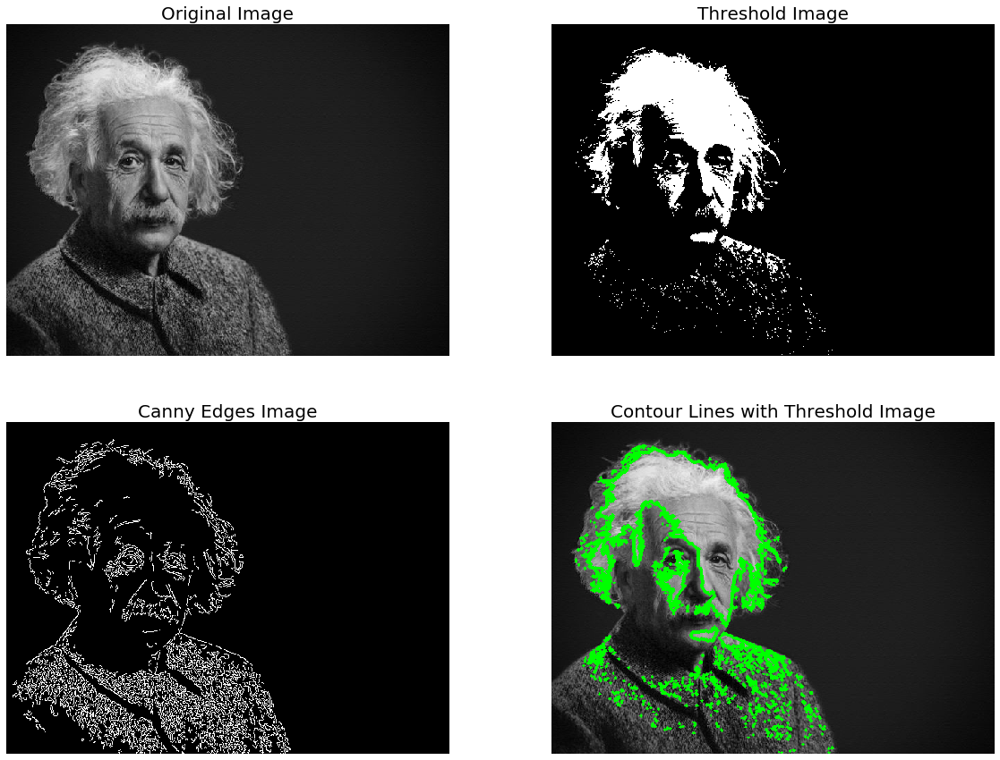

In [5]:
plt.figure(figsize=(20,15))
plt.subplot(221), plt.imshow(image), plt.title('Original Image', size=20), plt.axis('off')
plt.subplot(222), plt.imshow(thresh, cmap='gray'), plt.title('Threshold Image', size=20), plt.axis('off')
plt.subplot(223), plt.imshow(edged, cmap='gray'), plt.title('Canny Edges Image', size=20), plt.axis('off')
plt.subplot(224), plt.imshow(cv2.drawContours(np.copy(image), contours_thresh, -1, (0,255,0), 3))
plt.title('Contour Lines with Threshold Image', size=20), plt.axis('off')

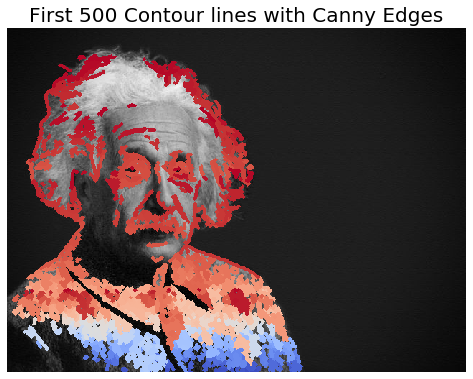

In [12]:
n = 500
plt.figure(figsize=(7,7))
colors = plt.cm.coolwarm(np.linspace(0, 1, n))
for i in range(n):
    image = cv2.drawContours(image, contours_edged, i, 255*colors[i], 3)
plt.imshow(image)
plt.title('First ' + str(n) + ' Contour lines with Canny Edges', size=20), plt.axis('off')
plt.tight_layout()
plt.show()

### 4.4 Creating different Hatched Contour Patterns for different levels with matplotlib

In [1]:
from skimage.io import imread
from skimage.color import rgb2gray

img = rgb2gray(imread('images/Img_01_01.jpg'))

In [4]:
y = np.arange(img.shape[0]) 
x = np.arange(img.shape[1]) 
x, y = np.meshgrid(x, y)
z = img

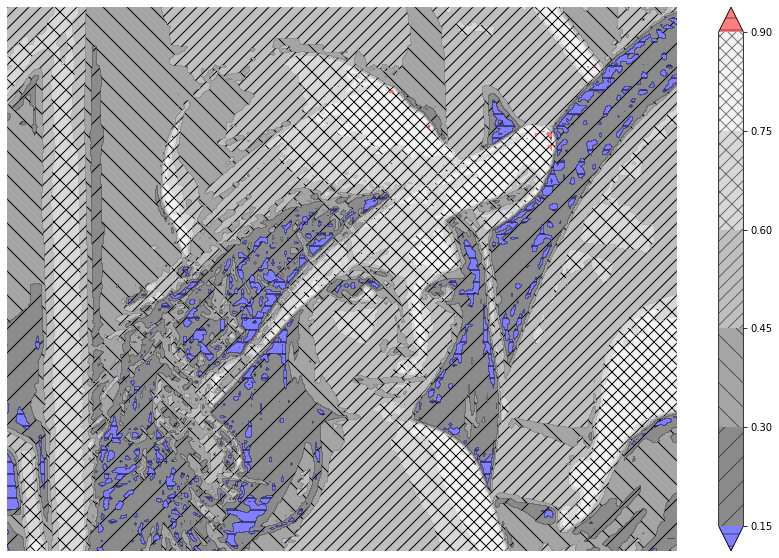

In [7]:
plt.figure(figsize=(15,10))
cs = plt.contourf(x, img.shape[0]-y, z, hatches=['-', '/', '\\', '//', '//\\', '//\\\\'], cmap='gray', extend='both', levels=6, alpha=0.5)
cs.cmap.set_over('red')
cs.cmap.set_under('blue')
cs.changed()
plt.colorbar()
plt.axis('off')
plt.show()

### 4.5 Counting Objects in an image

In [ ]:
import cv2
import numpy as np
import matplotlib.pylab as plt

image = cv2.imread('images/Img_01_12.jpg')
gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
edged = cv2.Canny(gray, 75, 150)

In [ ]:
thresh = cv2.threshold(gray, 215, 255, cv2.THRESH_BINARY_INV)[1]
kernel = np.ones((2,2),np.uint8)
thresh = cv2.morphologyEx(thresh, cv2.MORPH_CLOSE, kernel)

In [ ]:
# find contours (i.e., outlines) of the foreground objects in the thresholded image
_, cnts, _ = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
output = image.copy()

# loop over the contours
for c in cnts:
    # draw each contour on the output image with a 3px thick red
    # outline, then display the output contours one at a time
    cv2.drawContours(output, [c], -1, (0, 0, 255), 2) 

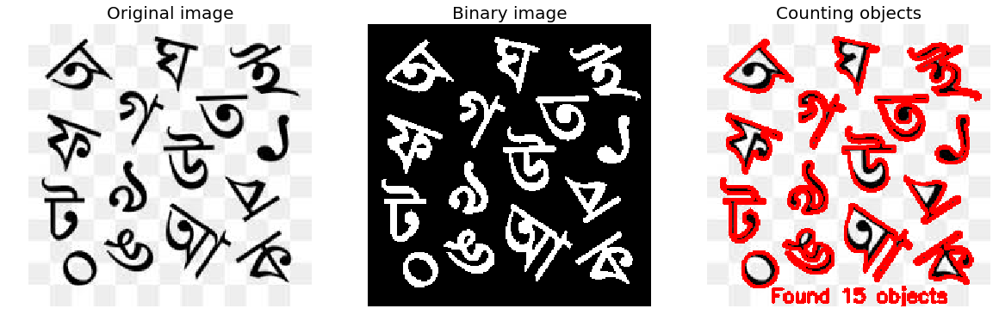

In [14]:
text = "Found {} objects".format(len(cnts))
cv2.putText(output, text, (50, 220),  cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 0, 255), 2)
plt.figure(figsize=(20,7))
plt.subplot(131), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('Original image', size=20)
plt.subplot(132), plt.imshow(thresh, cmap='gray'), plt.axis('off'), plt.title('Binary image', size=20)
plt.subplot(133), plt.imshow(cv2.cvtColor(output, cv2.COLOR_BGR2RGB)), plt.axis('off'), plt.title('Counting objects', size=20)
plt.show()

### 4.6 Convert a png image with palette to gray scale with PIL

P


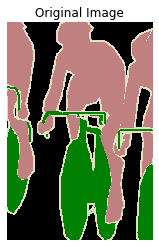

In [40]:
#The easy way

import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

img = Image.open('images/Img_01_07.png')
print(img.mode)

plt.imshow(img)
plt.axis('off')
plt.title('Original Image')
plt.show()

L


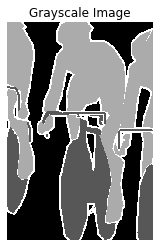

In [41]:
img = img.convert('RGB').convert('L')
print(img.mode)
plt.imshow(img, cmap='gray')
plt.axis('off')
plt.title('Grayscale Image')
plt.show()

In [35]:
# The hard way
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt

def rgb2gray(R, G, B):
    return 0.2989 * R + 0.5870 * G + 0.1140 * B 

img = Image.open('images/Img_01_07.png') # filename is the png file in question
pal = img.getpalette()     # get the palette

In [ ]:
arr = np.zeros((img.height, img.width)) # initialize the output image with zero values
for i in range(arr.shape[0]):
    for j in range(arr.shape[1]):
        idx = img.getpixel((j,i)) # get the index of the pixel in the palette
        R, G, B = pal[3*idx], pal[3*idx+1], pal[3*idx+2] # get the R,G,B values of the pixel
        arr[i,j] = rgb2gray(R, G, B) # convert to grayscale

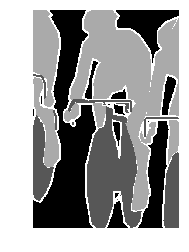

In [215]:
plt.imshow(arr, cmap='gray')
plt.title('Grayscale Image')
plt.axis('off')
plt.show()

### 4.7 Different ways to convert an RGB image to GrayScale

In [43]:
import numpy as np
from skimage.color import rgb2lab
from skimage.io import imread
import matplotlib.pylab as plt

def rgb2gray(img):
    gray_images = {}
    gray_images['intensity'] = np.mean(image, axis=2)
    gray_images['luminance'] = np.average(image, axis=2, weights=[0.3, 0.59, 0.11])
    gray_images['value'] = np.max(image, axis=2)
    gray_images['luster'] = (np.max(image, axis=2) + np.min(image, axis=2)) / 2
    gray_images['Lab L'] = rgb2lab(img)[...,0]
    gray_images['RGB R'] = img[...,0]
    return gray_images

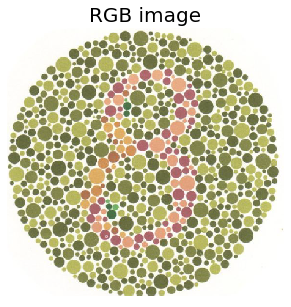

In [44]:
image = imread('images/Img_01_17.png')
plt.figure(figsize=(5,5))
plt.imshow(image), plt.axis('off'), plt.title('RGB image', size=20)
plt.show()

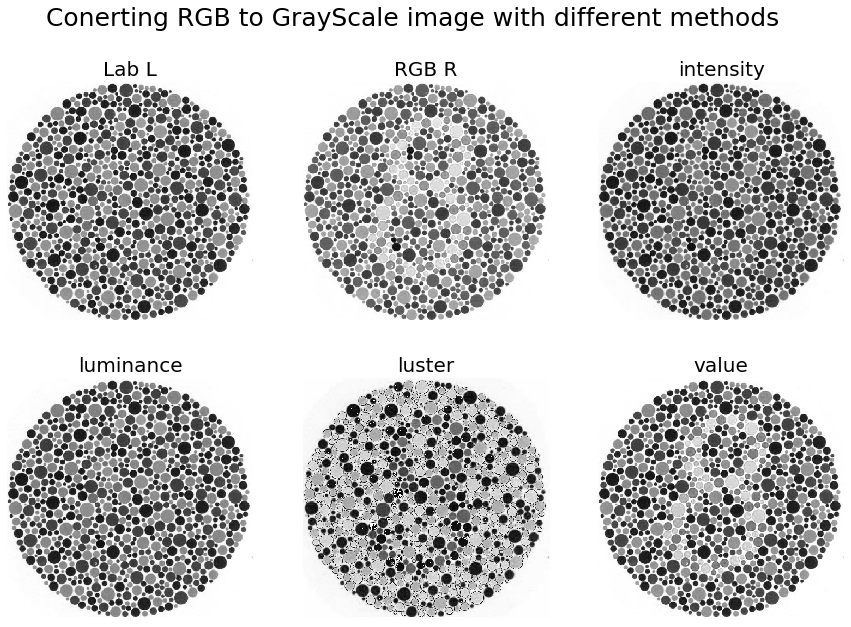

In [45]:
gray_images = rgb2gray(image)
i = 1
plt.figure(figsize=(15,10))
plt.gray()
for gray_type in sorted(gray_images):
    plt.subplot(2,3,i), plt.imshow(gray_images[gray_type]), plt.axis('off'), plt.title(gray_type, size=20)
    i += 1
plt.suptitle('Conerting RGB to GrayScale image with different methods', size=25)
plt.show()

### 4.8 Image Differences with PIL

In [ ]:
from PIL.ImageChops import difference
from PIL import Image

In [ ]:
im1 = Image.open("images/Img_01_08.jpg")
im2 = Image.open("images/Img_01_09.jpg").resize((im1.width, im1.height))

In [22]:
difference(im2, im1).show()
difference(im2, im1).save('images/Img_01_16.jpg')

![](images/Img_01_16.jpg)

### 4.9 RGB to hsv and Yuv color spaces with scikit-image

In [3]:
from skimage.io import imread
from skimage.color import rgb2hsv, hsv2rgb
import numpy as np
import matplotlib.pyplot as plt

![](images/Img_01_11.jpg)

In [15]:
im = imread("images/Img_01_11.jpg")
im_hsv = np.clip(rgb2hsv(im), 0, 1)

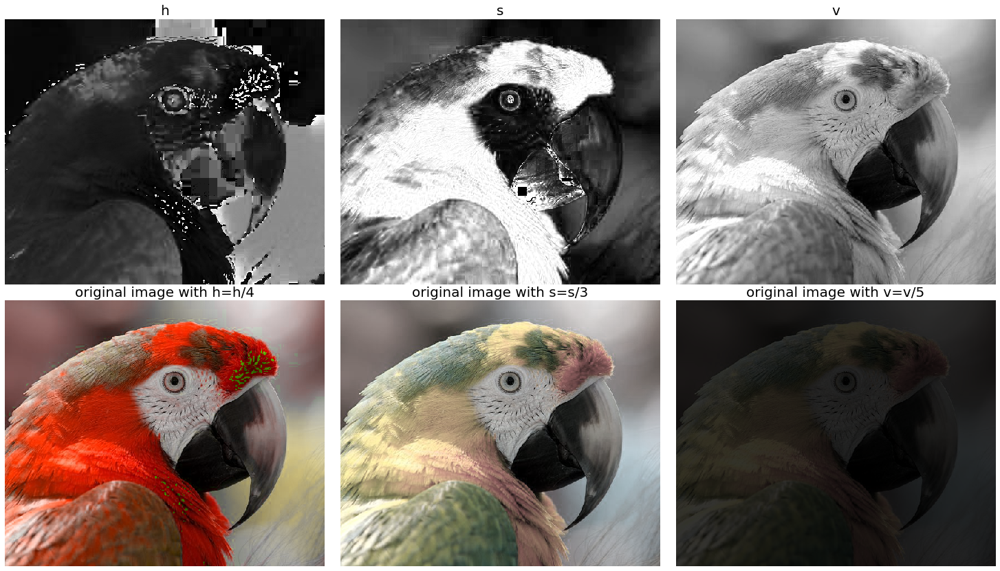

In [16]:
plt.figure(figsize=(20,12))
plt.subplots_adjust(0,0,1,0.925,0.05,0.05)
plt.gray()
plt.subplot(231), plt.imshow(im_hsv[...,0]), plt.title('h', size=20), plt.axis('off')
plt.subplot(232), plt.imshow(im_hsv[...,1]), plt.title('s', size=20), plt.axis('off')
plt.subplot(233), plt.imshow(im_hsv[...,2]), plt.title('v', size=20), plt.axis('off')
im_hsv_copy = np.copy(im_hsv)
im_hsv[...,0] /= 4
plt.subplot(234), plt.imshow(np.clip(hsv2rgb(im_hsv), 0, 1)), plt.title('original image with h=h/4', size=20), plt.axis('off')
im_hsv = im_hsv_copy
im_hsv[...,1] /= 3
plt.subplot(235), plt.imshow(np.clip(hsv2rgb(im_hsv), 0, 1)), plt.title('original image with s=s/3', size=20), plt.axis('off')
im_hsv = im_hsv_copy
im_hsv[...,2] /= 5
plt.subplot(236), plt.imshow(np.clip(hsv2rgb(im_hsv), 0, 1)), plt.title('original image with v=v/5', size=20), plt.axis('off')
plt.show()

In [19]:
from skimage.color import rgb2yuv, yuv2rgb

![](images/Img_01_04.jpg)

In [24]:
im = imread("images/Img_01_04.jpg")
im_Yuv = rgb2yuv(im)

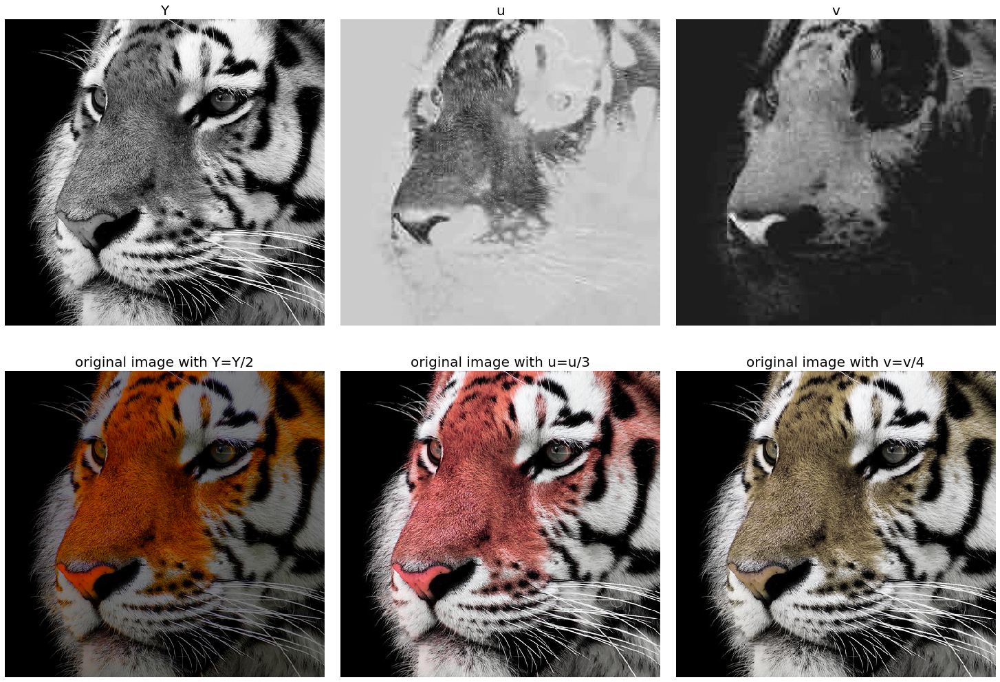

In [25]:
plt.figure(figsize=(20,15))
plt.subplots_adjust(0,0,1,0.925,0.05,0.05)
plt.gray()
plt.subplot(231), plt.imshow(im_Yuv[...,0]), plt.title('Y', size=20), plt.axis('off')
plt.subplot(232), plt.imshow(im_Yuv[...,1]), plt.title('u', size=20), plt.axis('off')
plt.subplot(233), plt.imshow(im_Yuv[...,2]), plt.title('v', size=20), plt.axis('off')
im_Yuv_copy = np.copy(im_Yuv)
im_Yuv[...,0] /= 2
plt.subplot(234), plt.imshow(np.clip(yuv2rgb(im_Yuv),0,1)), plt.title('original image with Y=Y/2', size=20), plt.axis('off')
im_Yuv = im_Yuv_copy
im_Yuv[...,1] /= 3
plt.subplot(235), plt.imshow(np.clip(yuv2rgb(im_Yuv),0,1)), plt.title('original image with u=u/3', size=20), plt.axis('off')
im_Yuv = im_Yuv_copy
im_Yuv[...,2] /= 4
plt.subplot(236), plt.imshow(np.clip(yuv2rgb(im_Yuv),0,1)), plt.title('original image with v=v/4', size=20), plt.axis('off')
plt.show()

### 4.10 Resizing an image with opencv-python

In [ ]:
import cv2
import matplotlib.pylab as plt
im = cv2.imread("images/Img_01_10.jpg") 
interps = ['nearest', 'bilinear', 'area', 'lanczos', 'bicubic']

(55, 55, 3) (220, 220, 3)


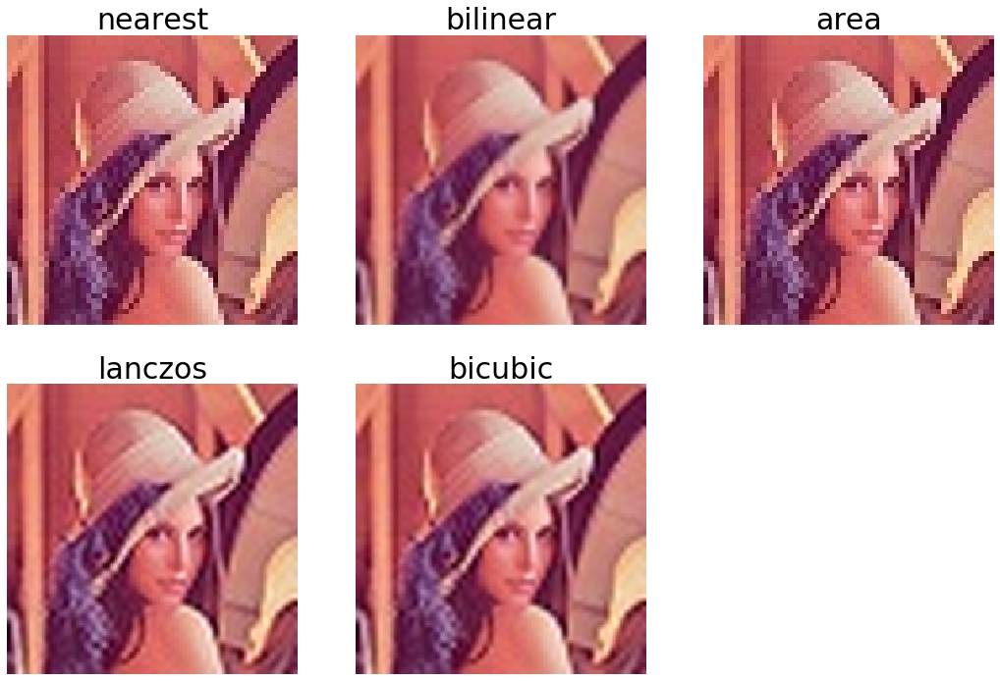

In [2]:
i = 1
plt.figure(figsize=(18,12))
for interp in [cv2.INTER_NEAREST, cv2.INTER_LINEAR, cv2.INTER_AREA, cv2.INTER_LANCZOS4, cv2.INTER_CUBIC]:
 im1 = cv2.resize(im, None, fx=4., fy=4., interpolation = interp) # 4 times
 plt.subplot(2,3,i)
 plt.imshow(cv2.cvtColor(im1, cv2.COLOR_BGR2RGB))
 plt.axis('off')
 plt.title(interps[i-1], size=30)
 i += 1
print(im.shape, im1.shape)
plt.show()

### 4.11 Add a logo to an image with scikit-image

In [15]:
from skimage.io import imread
from skimage.color import rgb2gray, gray2rgb
import numpy as np
import matplotlib.pylab as plt
# Load two images
img1 = imread('images/Img_01_13.png').astype(np.uint8)
img2 = imread('images/Img_01_14.jpg').astype(np.uint8) # logo

In [16]:
# put logo on top-left corner, So create a ROI
rows, cols, _ = img2.shape
roi = img1[0:rows, 0:cols]
# Now create a mask of logo and create its inverse mask also
img2gray = (255*rgb2gray(img2)).astype(np.uint8)
mask = 255*(img2gray < 150) #cv2.threshold(img2gray, 10, 255, cv2.THRESH_BINARY)

In [17]:
mask_inv = np.invert(mask) #cv2.bitwise_not(mask)
mask_inv = mask_inv.astype(np.uint8)
# Now black-out the area of logo in ROI
img1_bg = np.bitwise_and(roi, gray2rgb(mask_inv)) #cv2.bitwise_and(roi,roi,mask = mask_inv)

In [18]:
# Take only region of logo from logo image.
img2_fg = np.bitwise_and(img2, gray2rgb(mask)) # cv2.bitwise_and(img2,img2,mask = mask)

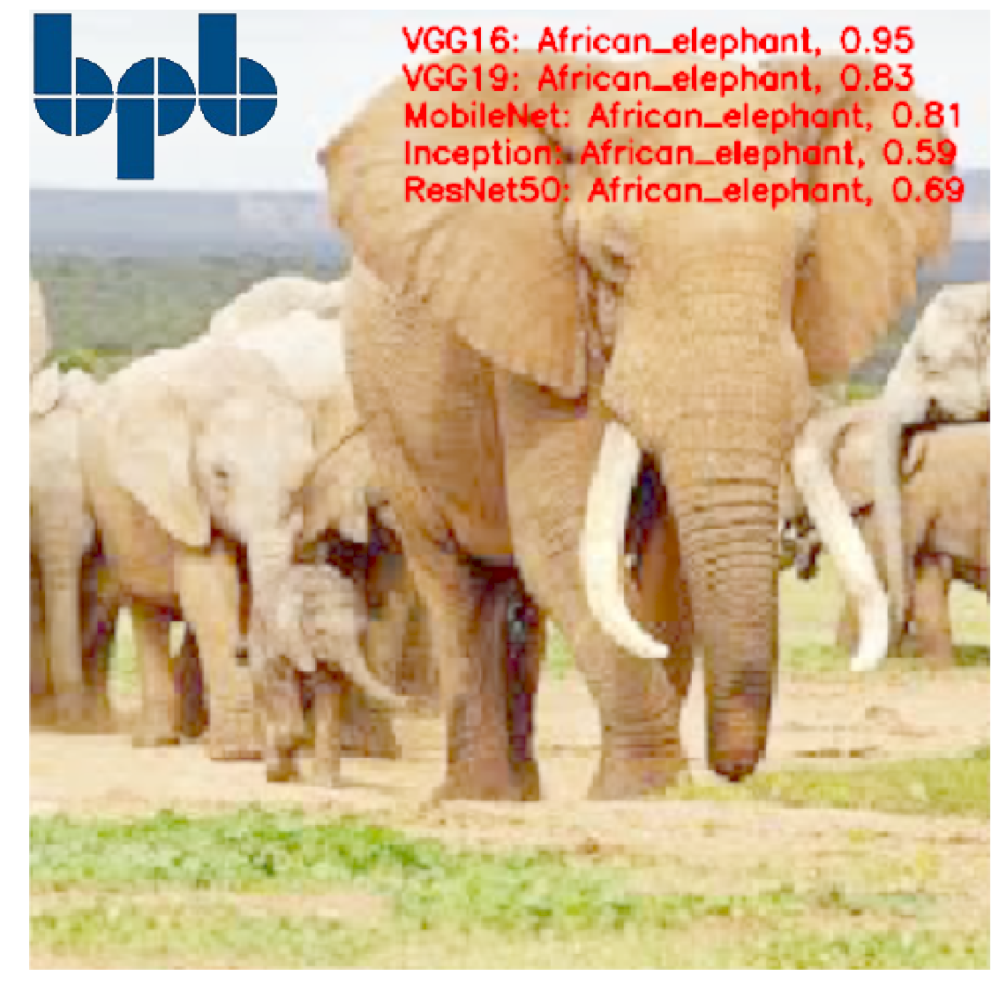

In [68]:
# Put logo in ROI and modify the main image
dst = img1_bg + img2_fg
img1[0:rows, 0:cols ] = dst
plt.figure(figsize=(20,20))
plt.imshow(img1)
plt.axis('off')
plt.show()

### 4.12 Change brightness / contrast of an image with linear transform and gamma correction with opencv-python

In [3]:
import cv2
import numpy as np
import matplotlib.pylab as plt

alpha, beta, gamma = 1, 0, 1

def basic_linear_transform(img, alpha, beta):
    return cv2.convertScaleAbs(img, alpha=alpha, beta=beta)

def gamma_correction(img, gamma):
    lookup_table = np.empty((1,256), np.uint8)
    for i in range(256):
        lookup_table[0,i] = np.clip(pow(i / 255.0, gamma) * 255.0, 0, 255)
    return cv2.LUT(img, lookup_table)

image = cv2.imread('images/Img_01_01.jpg') 

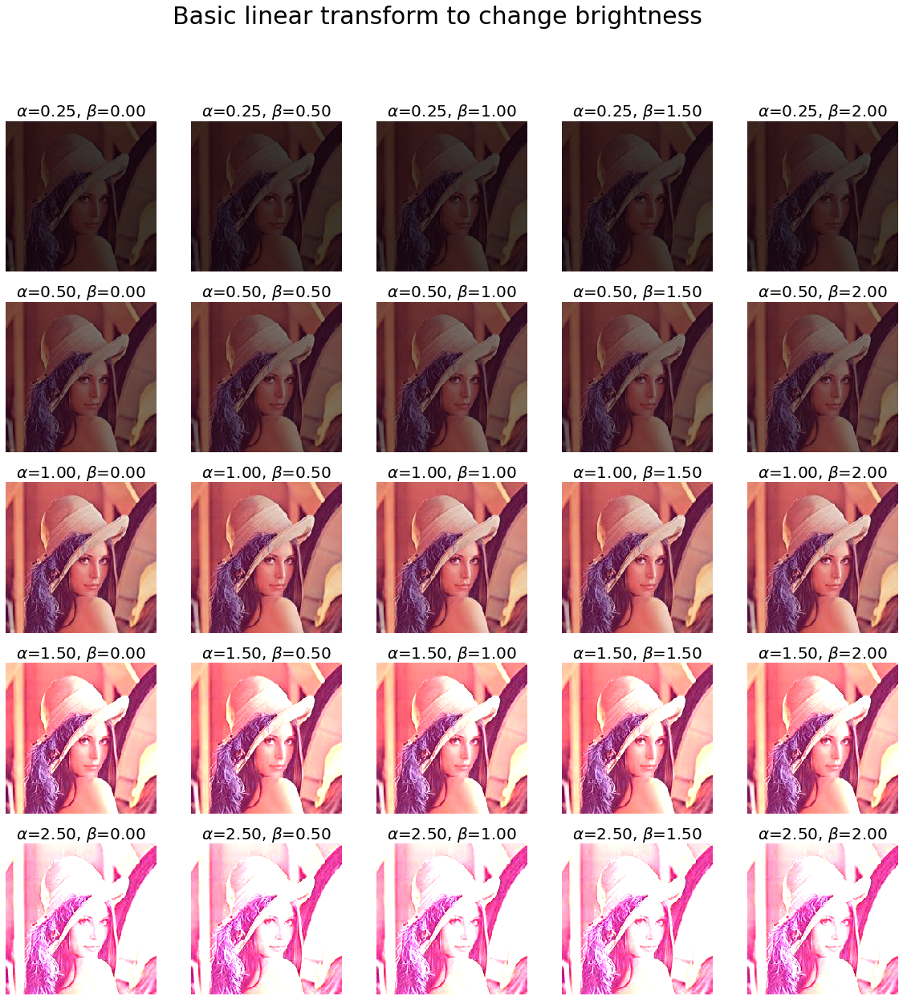

In [4]:
plt.figure(figsize=(20,20))
i = 1
for alpha in [0.25, 0.5, 1, 1.5, 2.5]:
    for beta in [0, 0.5, 1, 1.5, 2]:
        image_corrected = basic_linear_transform(image, alpha, beta)
        plt.subplot(5,5,i), plt.imshow(cv2.cvtColor(image_corrected, cv2.COLOR_BGR2RGB)), plt.axis('off')
        plt.title(r'$\alpha$={:.2f}, $\beta$={:.2f}'.format(alpha, beta), size=20)
        i += 1
plt.suptitle('Basic linear transform to change brightness', size=30)
plt.show()

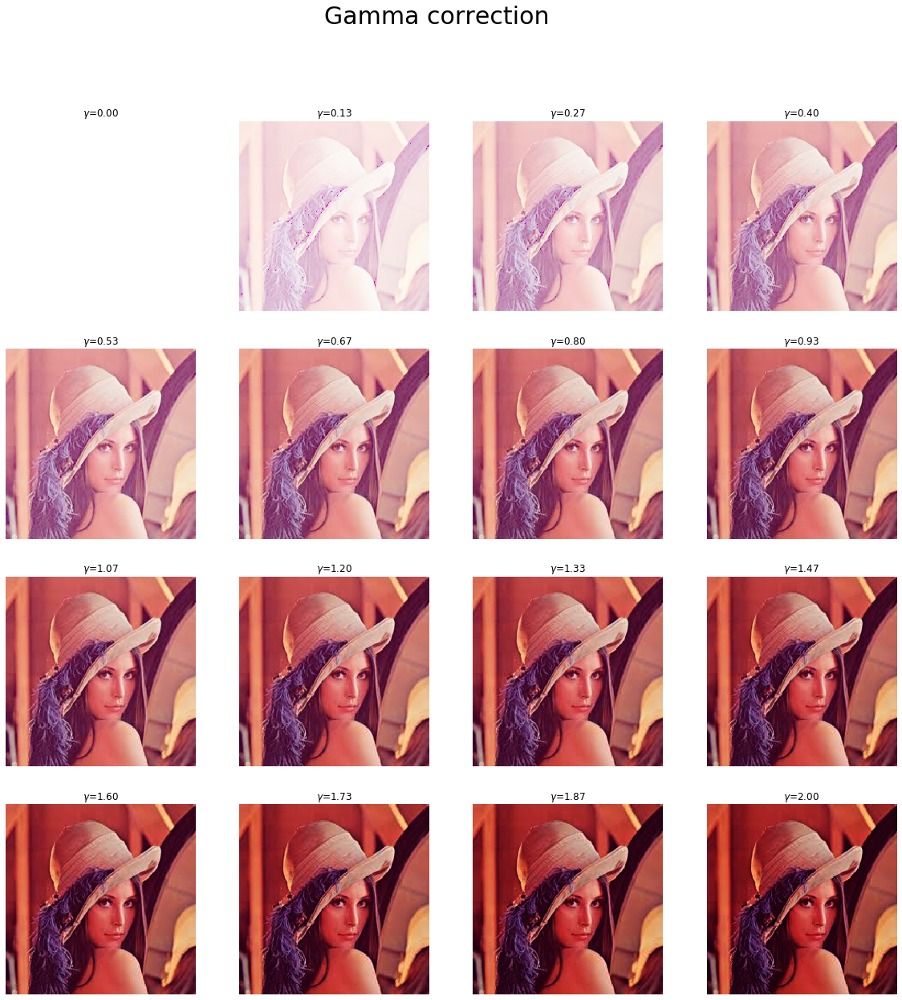

In [5]:
plt.figure(figsize=(20,20))
i = 1
for gamma in np.linspace(0, 2, 16):
    image_gamma_corrected = gamma_correction(image, gamma)
    plt.subplot(4,4,i), plt.imshow(cv2.cvtColor(image_gamma_corrected, cv2.COLOR_BGR2RGB)), plt.axis('off')
    plt.title(r'$\gamma$={:.2f}'.format(gamma))
    i += 1
plt.suptitle('Gamma correction', size=30)
plt.show()

## 5. Object Removal with Seam Carving

In [8]:
# pip install scikit-image==0.14.2
import skimage
print(skimage.__version__)
# 0.14.2
from skimage.io import imread
from skimage.color import rgb2gray
from skimage.transform import seam_carve
import matplotlib.pylab as plt

0.14.2


(1536, 1079, 3)


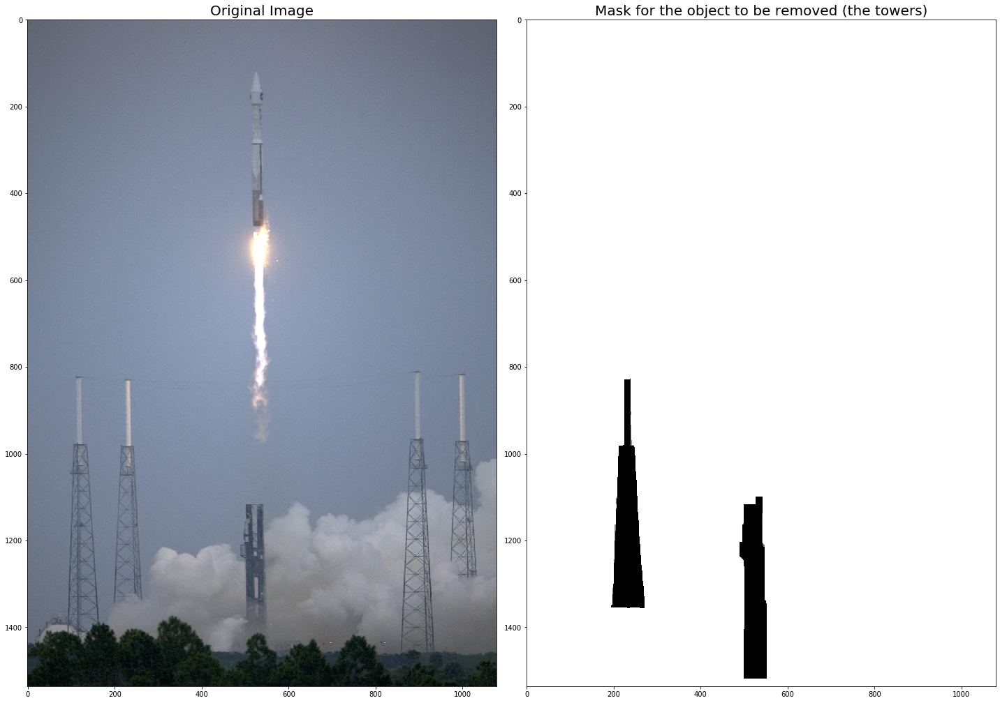

In [9]:
image = imread('images/Img_01_27.png')
mask_image = rgb2gray(imread('images/Img_01_28.png'))
print(image.shape)
plt.figure(figsize=(20,20))
plt.subplot(121), plt.imshow(image), plt.title('Original Image', size=20)
plt.subplot(122), plt.imshow(mask_image, cmap='gray'), plt.title('Mask for the object to be removed (the towers)', size=20)
plt.tight_layout()
plt.show()

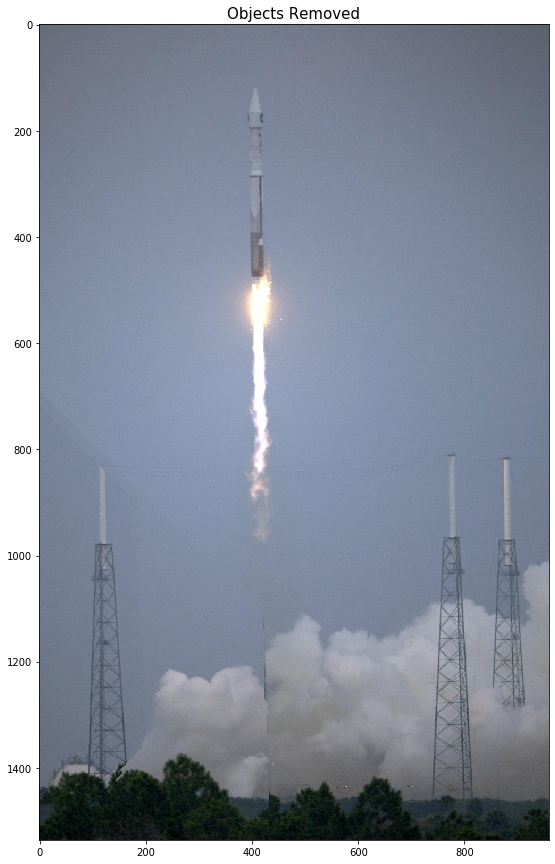

In [6]:
plt.figure(figsize=(10,15))
plt.title('Objects Removed', size=15)
out = seam_carve(image, mask_image, 'verical', 120)
plt.imshow(out)
plt.show()

## 6. Create Fake Miniature Effect

In [33]:
from PIL import Image, ImageEnhance, ImageFilter
from scipy.ndimage import binary_erosion
from PIL.ImageFilter import GaussianBlur
import matplotlib.pyplot as plt, numpy as np

In [34]:
def apply_gradient_blur(image, mask, n=10, radius=1):
    mask = mask.convert("1")
    for i in range(n):
        mask = binary_erosion(np.array(mask), structure=np.ones((10,10)), border_value=1)
        im_blur = image.filter(GaussianBlur(radius=radius))
        image.paste(im_blur, mask=Image.fromarray(mask))
    return image

In [35]:
def create_fake_miniature(im, custom_mask, color=1.9, contrast=1.4, blur_radius=1.3):
    # Cranking up the contrast and color
    edited = ImageEnhance.Contrast(ImageEnhance.Color(im).enhance(color)).enhance(contrast)
    # Blurring the image and merging
    im_blur = apply_gradient_blur(edited.copy(), mask.copy(), n=50, radius=blur_radius)
    edited = edited.convert("RGBA")
    edited.paste(im_blur, mask=mask)
    return edited

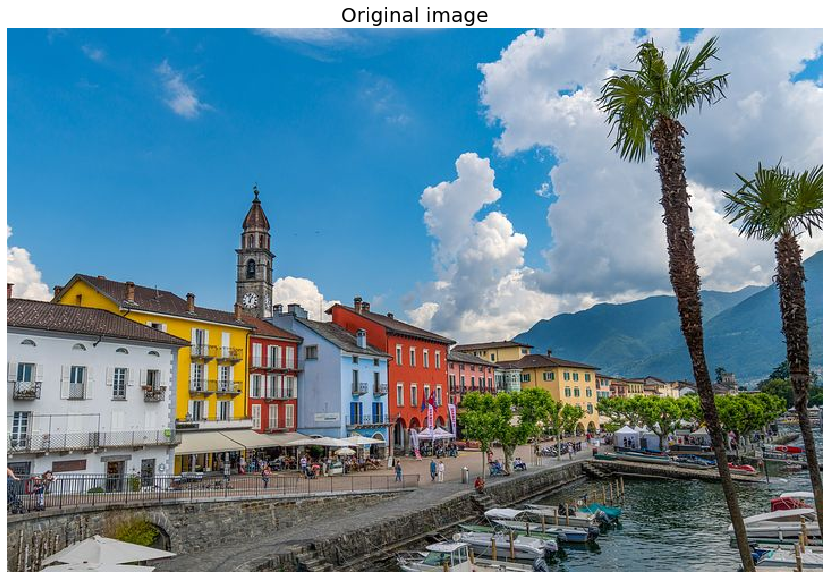

In [36]:
im = Image.open("images/Img_01_29.png")
mask = Image.open("images/Img_01_30.png")
out = create_fake_miniature(im, mask)
plt.figure(figsize=(20,10))
plt.imshow(im), plt.axis('off'), plt.title('Original image', size=20)
plt.show()

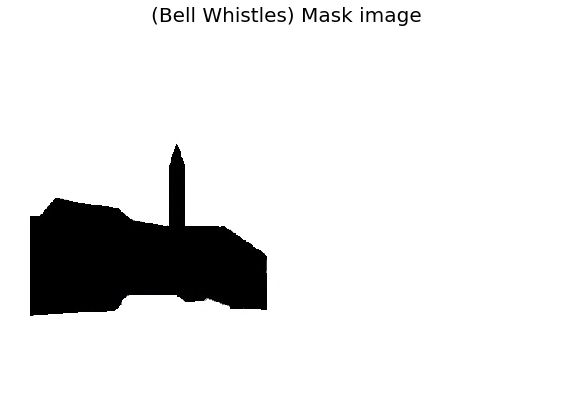

In [37]:
plt.figure(figsize=(10,10))
plt.imshow(mask), plt.axis('off'), plt.title('(Bell Whistles) Mask image', size=20)
plt.show()

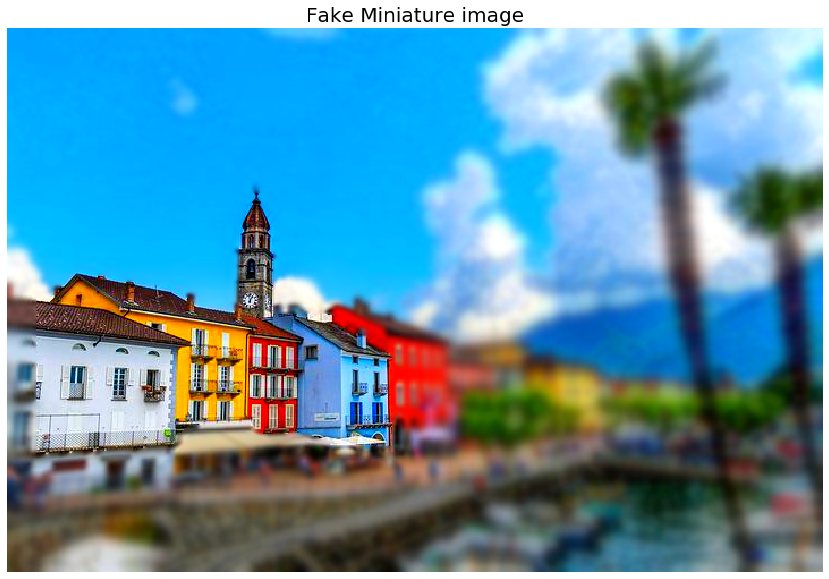

In [38]:
plt.figure(figsize=(20,10))
plt.imshow(out), plt.axis('off'), plt.title('Fake Miniature image', size=20)
plt.show()